<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Import-libraries" data-toc-modified-id="Import-libraries-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Import libraries</a></span></li><li><span><a href="#Data-loading" data-toc-modified-id="Data-loading-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Data loading</a></span></li><li><span><a href="#EDA" data-toc-modified-id="EDA-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>EDA</a></span><ul class="toc-item"><li><span><a href="#Basic-Information" data-toc-modified-id="Basic-Information-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Basic Information</a></span></li><li><span><a href="#Data-profiling" data-toc-modified-id="Data-profiling-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Data profiling</a></span></li><li><span><a href="#Transform-continuous-price-to-2-classes" data-toc-modified-id="Transform-continuous-price-to-2-classes-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Transform continuous price to 2 classes</a></span></li></ul></li><li><span><a href="#Logistic-Regresstion" data-toc-modified-id="Logistic-Regresstion-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Logistic Regresstion</a></span><ul class="toc-item"><li><span><a href="#[sklearn]-Baseline-classification-model" data-toc-modified-id="[sklearn]-Baseline-classification-model-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>[sklearn] Baseline classification model</a></span></li><li><span><a href="#[scratch]-gradient-descent-loss-minimization" data-toc-modified-id="[scratch]-gradient-descent-loss-minimization-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>[scratch] gradient descent loss minimization</a></span></li><li><span><a href="#[scratch]-MLE" data-toc-modified-id="[scratch]-MLE-4.3"><span class="toc-item-num">4.3&nbsp;&nbsp;</span>[scratch] MLE</a></span></li></ul></li></ul></div>

# Import libraries

In [26]:
import time
import numpy as np
import pandas as pd
import pandas_profiling #simple fast EDA
import seaborn as sns #statistical data visualization
import matplotlib.pyplot as plt

from sklearn import preprocessing
from sklearn.model_selection import train_test_split # to split the data
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix,recall_score,precision_score, precision_recall_curve,auc,roc_curve,roc_auc_score,classification_report
%matplotlib inline

# Data loading

In [8]:
#read data
data = pd.read_csv('data/kaggle_house_data.csv')

In [9]:
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


# EDA

## Basic Information

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [11]:
data.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [12]:
#check na
data[data.isna().any(axis=1)]
data.isna().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

## Data profiling

In [13]:
pandas_profiling.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Transform continuous price to 2 classes

D:\Learning Material\ml_env\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='price', ylabel='Density'>

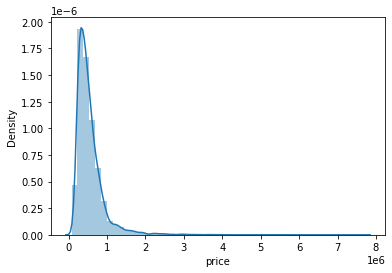

In [14]:
#distribution plot of y variables
sns.distplot(data['price'])

In [15]:
#continuous to categorical (2 classes, cut at median 450,000)
y_mat = data['price'].values.ravel()
y_class = pd.cut(y_mat,
                bins=[0, 450000, 7700000],
                labels=[0, 1])

In [16]:
data_class = pd.concat([data,round(pd.DataFrame(y_class)).astype('category')],axis=1)
data_class = data_class.rename(columns={0: "Class"})

In [17]:
#check na
data_class[data_class.isna().any(axis=1)]
data_class.isna().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
Class            0
dtype: int64

In [18]:
#remove id, date, and price
columns = ['id','date','price']
data_class.drop(columns,inplace=True,axis=1)
data_class.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,Class
0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,0
1,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639,1
2,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062,0
3,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,1
4,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,1


In [19]:
#distribution of class 0 and 1
data_class["Class"].value_counts()

0    10864
1    10749
Name: Class, dtype: int64

In [20]:
data_filter = data_class[['sqft_living','bedrooms','Class']].copy() 

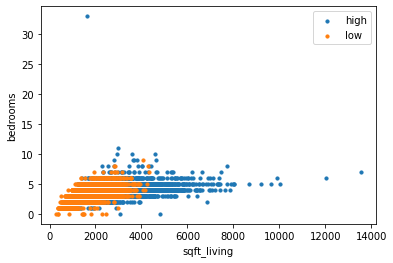

In [21]:
# X = feature values, all the columns except the last column
X = data_filter.iloc[:, :-1]

# y = target values, last column of the data frame
y = data_filter.iloc[:, -1]

# filter out the applicants that got admitted
high = data_filter.loc[y == 1]

# filter out the applicants that din't get admission
low = data_filter.loc[y == 0]

# plots
plt.scatter(high.iloc[:, 0], high.iloc[:, 1], s=10, label='high')
plt.scatter(low.iloc[:, 0], low.iloc[:, 1], s=10, label='low')
plt.xlabel("sqft_living")
plt.ylabel("bedrooms")
plt.legend()
plt.show()

# Logistic Regresstion

## [sklearn] Baseline classification model

In [22]:
def train_test_split_preprocessing(df):
    #data_df
    features= df.loc[:,df.columns != "Class"]
    labels=df.loc[:,df.columns=="Class"]

    X_train, X_test, y_train, y_test = train_test_split(features,labels,test_size=0.2, random_state=123)

    print("\nLen of X_train: {a}".format(a = len(X_train)))
    print("Len of X_test: {a}".format(a = len(X_test)))
    
    print("\nVariables: {a}".format(a=list(X_train.columns)))
    
    print("\nIn train label:")
    print(y_train["Class"].value_counts())
    
    print("\nIn test label:")
    print(y_test["Class"].value_counts())
    return (X_train, X_test, y_train, y_test)

In [23]:
def model(model, X_train, X_test, y_train, y_test):
    clf = model
    clf.fit(X_train,y_train) #.values.ravel()
    pred=clf.predict(X_test)
    
    print("========== MODEL DETAILS ==========")
    print(clf, "\n")
    
    print("========== CONFUSION MATRIX ==========")
    confusion_matrix_df=pd.DataFrame(confusion_matrix(y_test,pred))
    confusion_matrix_df.columns = ['Predicted 0', 'Predicted 1']
    confusion_matrix_df = confusion_matrix_df.rename({0: 'Actual 0', 1: 'Actual 1'})
    print(confusion_matrix_df, "\n")

    print("========== CLASSIFICATION REPORT ==========")
    print(classification_report(y_test,pred), "\n")

    print("========== ROC CURVE ==========")
    AUC = round(roc_auc_score(y_test,pred),4)
    print("AUC: {a}".format(a = AUC))
    
    FP, TP, _ = roc_curve(y_test,pred,pos_label=1)

    plt.plot(FP,TP,label="data 1, auc="+str(AUC))
    plt.title("ROC Curve")
    plt.legend(loc=4)
    plt.show()
    
    return clf

In [24]:
X_train, X_test, y_train, y_test = train_test_split_preprocessing(data_filter)


Len of X_train: 17290
Len of X_test: 4323

Variables: ['sqft_living', 'bedrooms']

In train label:
0    8716
1    8574
Name: Class, dtype: int64

In test label:
1    2175
0    2148
Name: Class, dtype: int64


D:\Learning Material\ml_env\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


========== MODEL DETAILS ==========
LogisticRegression(multi_class='ovr', random_state=0) 

========== CONFUSION MATRIX ==========
          Predicted 0  Predicted 1
Actual 0         1684          464
Actual 1          727         1448 

========== CLASSIFICATION REPORT ==========
              precision    recall  f1-score   support

           0       0.70      0.78      0.74      2148
           1       0.76      0.67      0.71      2175

    accuracy                           0.72      4323
   macro avg       0.73      0.72      0.72      4323
weighted avg       0.73      0.72      0.72      4323
 

========== ROC CURVE ==========
AUC: 0.7249


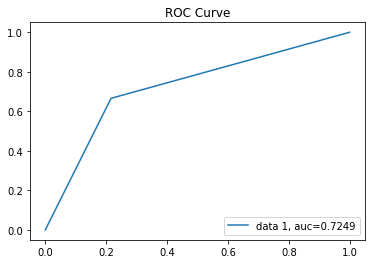

In [27]:
clf = model(LogisticRegression(random_state=0, multi_class='ovr'),X_train, X_test, y_train, y_test)

## [scratch] gradient descent loss minimization

In [28]:
#split train test
X_train, X_test, y_train, y_test = train_test_split_preprocessing(data_filter)
y_train = pd.to_numeric(y_train['Class'].copy())
y_test = pd.to_numeric(y_test['Class'].copy())


Len of X_train: 17290
Len of X_test: 4323

Variables: ['sqft_living', 'bedrooms']

In train label:
0    8716
1    8574
Name: Class, dtype: int64

In test label:
1    2175
0    2148
Name: Class, dtype: int64


In [29]:
#logistic function
def sigmoid(X, weight):
    z = np.dot(X, weight)
    return 1 / (1 + np.exp(-z))

#gradient descent function
#X.T is to transform the shape of array from (21613, 19) to (19, 21613)
def gradient_descent(X, h, y):
    return np.dot(X.T, (h - y)) / y.shape[0] 

#update weight loss
def update_weight_loss(weight, learning_rate, gradient):
    return weight - learning_rate * gradient

#cost function
def loss(h, y):
    return (-y * np.log(h) - (1 - y) * np.log(1 - h)).mean()

In [30]:
#logistic regression scratch function

def LogisticRegressionWX(X_train, X_test, y_train, y_test):
    
    #train model
    start_time = time.time()

    num_iter = 1000
    intercept = np.ones((X_train.shape[0], 1))  #0 is the rows, initialize the intercept as 1
    X_train = np.concatenate((intercept, X_train), axis=1) #join the intercept to train variables
    theta = np.zeros(X_train.shape[1])  #1 is the columns, initialize the weight with 0

    #predicting theta
    for i in range(num_iter):
        h = sigmoid(X_train, theta)
        gradient = gradient_descent(X_train, h, y_train)
        theta = update_weight_loss(theta, 0.0001, gradient) #final theta/ weight from the trained model
        
    #print training information
    print("=============== TRAINING INFORMATION ===============\n")
    print("Training time (Log Reg using Gradient descent):" + str(time.time() - start_time) + " seconds")
    print("Learning rate: {}\nIteration: {}".format(0.0001, num_iter))    
    
    #training result
    result = sigmoid(X_train, theta) 
    #reset index of y
    y_train = y_train.reset_index(drop=True)
    #join predicted result and actual result
    f_train = pd.DataFrame(result).join(y_train) 
    #threshold for classification
    f_train['pred'] = f_train[0].apply(lambda x : 0 if x <=0.5 else 1)

    #print theta
    print("Theta: " , theta)
    
    #print training accuracy
    print("Accuracy (Loss minimization):")
    print(f_train.loc[f_train['pred']==f_train['Class']].shape[0] / f_train.shape[0] * 100, "\n")
    
    ###############################################################################################################   
    print("=============== TESTING INFORMATION ===============\n")
    #test the trained model on test data
    intercept = np.ones((X_test.shape[0], 1))  #0 is the rows, initialize the intercept as 1
    X_test = np.concatenate((intercept, X_test), axis=1) #join the intercept to test variables
    result = sigmoid(X_test, theta) 
    
    #reset index of y
    y_test = y_test.reset_index(drop=True)
    
    #model performance evaluation
    f_test = pd.DataFrame(np.around(result, decimals=6)).join(y_test) #reset index of y
    f_test['pred'] = f_test[0].apply(lambda x : 0 if x <= 0.5 else 1)
    print("Accuracy (Loss minimization):")
    print(f_test.loc[f_test['pred']==f_test['Class']].shape[0] / f_test.shape[0] * 100, "\n")
    
    print("Loss:" + str(loss(f_test['pred'],f_test['Class'])), "\n")
    
    
    print("========== CONFUSION MATRIX ==========")
    confusion_matrix_df=pd.DataFrame(confusion_matrix(y_test,f_test['pred']))
    confusion_matrix_df.columns = ['Predicted 0', 'Predicted 1']
    confusion_matrix_df = confusion_matrix_df.rename({0: 'Actual 0', 1: 'Actual 1'})
    print(confusion_matrix_df, "\n")

    print("========== CLASSIFICATION REPORT ==========")
    print(classification_report(y_test,f_test['pred']), "\n")

    print("========== ROC CURVE ==========")
    AUC = round(roc_auc_score(y_test,f_test['pred']),4)
    print("AUC: {a}".format(a = AUC))
    
    FP, TP, _ = roc_curve(y_test,f_test['pred'],pos_label=1)

    plt.plot(FP,TP,label="data 1, auc="+str(AUC))
    plt.title("ROC Curve")
    plt.legend(loc=4)
    plt.show()
    
    print("========== PRECISION-RECALL CURVE ==========")
    precision, recall, thresholds = precision_recall_curve(y_test, result)
    # plot the precision-recall curve for the model
    plt.plot(recall, precision, marker='.')

C:\Users\ooi.weixin\AppData\Local\Temp\ipykernel_36172\1229726553.py:4: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-z))


=============== TRAINING INFORMATION ===============

Training time (Log Reg using Gradient descent):0.5013737678527832 seconds
Learning rate: 0.0001
Iteration: 1000
Theta:  [-0.01101804 -0.06158841 -0.02504286]
Accuracy (Loss minimization):
50.41064198958936 

=============== TESTING INFORMATION ===============

Accuracy (Loss minimization):
49.68771686328938 

Loss:inf 

========== CONFUSION MATRIX ==========
          Predicted 0  Predicted 1
Actual 0         2148            0
Actual 1         2175            0 

========== CLASSIFICATION REPORT ==========
              precision    recall  f1-score   support

           0       0.50      1.00      0.66      2148
           1       0.00      0.00      0.00      2175

    accuracy                           0.50      4323
   macro avg       0.25      0.50      0.33      4323
weighted avg       0.25      0.50      0.33      4323
 

========== ROC CURVE ==========
AUC: 0.5


D:\Learning Material\ml_env\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Learning Material\ml_env\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
D:\Learning Material\ml_env\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
D:\Learning Material\ml_env\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with 

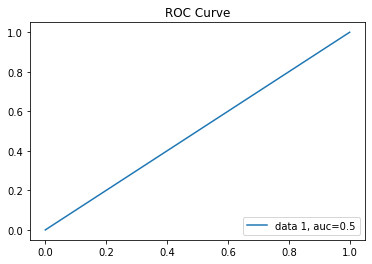

========== PRECISION-RECALL CURVE ==========


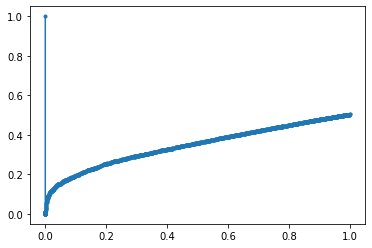

In [31]:
LogisticRegressionWX(X_train, X_test, y_train, y_test)

## [scratch] MLE

In [32]:
#temporary_try on 2 features only
data_class2 = data_class[['sqft_living','grade','Class']].copy()

#split train test
X_train, X_test, y_train, y_test = train_test_split_preprocessing(data_class2)
y_train = pd.to_numeric(y_train['Class'].copy())
y_test = pd.to_numeric(y_test['Class'].copy())


Len of X_train: 17290
Len of X_test: 4323

Variables: ['sqft_living', 'grade']

In train label:
0    8716
1    8574
Name: Class, dtype: int64

In test label:
1    2175
0    2148
Name: Class, dtype: int64


In [33]:
def gradient_ascent(X, h, y):
    return np.dot(X.T, y - h)
def update_weight_mle(weight, learning_rate, gradient):
    return weight + learning_rate * gradient

In [34]:
#logistic regression scratch function
def LogisticRegressionMLE(X_train, X_test, y_train, y_test):
    
    #train model
    start_time = time.time()
    num_iter = 1000

    intercept = np.ones((X_train.shape[0], 1))
    X_train = np.concatenate((intercept, X_train), axis=1)
    theta = np.zeros(X_train.shape[1])

    for i in range(num_iter):
        h = sigmoid(X_train, theta)
        gradient = gradient_ascent(X_train, h, y_train) #np.dot(X.T, (h - y)) / y.size
        theta = update_weight_mle(theta, 0.1, gradient)

    #print model training information
    print("Training time (Log Reg using MLE):" + str(time.time() - start_time) + "seconds")
    print("Learning rate: {}\nIteration: {}".format(0.1, num_iter))
    
    #performance on train set
    result = sigmoid(X_train, theta)
    print("Accuracy (Maximum Likelihood Estimation): ")
    #reset index of y
    y_train = y_train.reset_index(drop=True)
    #join predicted result and actual result
    f_train = pd.DataFrame(result).join(y_train)
    print(f_train.loc[f_train[0]==f_train['Class']].shape[0] / f_train.shape[0] * 100)

    #print theta
    print("Theta: " , theta)
    
    #print training accuracy
    print("Accuracy (Loss minimization):")
    print(f_train.loc[f_train[0]==f_train['Class']].shape[0] / f_train.shape[0] * 100, "\n")
    
    ###############################################################################################################   
    print("=============== TESTING INFORMATION ===============\n")
    #test the trained model on test data
    intercept = np.ones((X_test.shape[0], 1))  #0 is the rows, initialize the intercept as 1
    X_test = np.concatenate((intercept, X_test), axis=1) #join the intercept to test variables
    result = sigmoid(X_test, theta) 
    
    #performance on test set
    print("Accuracy (Maximum Likelihood Estimation): ")
    #reset index of y
    y_test = y_test.reset_index(drop=True)
    #join predicted result and actual result
    f_test = pd.DataFrame(result).join(y_test)
    print(f_test.loc[f_test[0]==f_test['Class']].shape[0] / f_test.shape[0] * 100)
    
    print("Loss:" + str(loss(f_test[0],f_test['Class'])), "\n")
    
    
    print("========== CONFUSION MATRIX ==========")
    confusion_matrix_df=pd.DataFrame(confusion_matrix(y_test,f_test[0]))
    confusion_matrix_df.columns = ['Predicted 0', 'Predicted 1']
    confusion_matrix_df = confusion_matrix_df.rename({0: 'Actual 0', 1: 'Actual 1'})
    print(confusion_matrix_df, "\n")

    print("========== CLASSIFICATION REPORT ==========")
    print(classification_report(y_test,f_test[0]), "\n")

    print("========== ROC CURVE ==========")
    AUC = round(roc_auc_score(y_test,f_test[[0]]),4)
    print("AUC: {a}".format(a = AUC))
    
    FP, TP, _ = roc_curve(y_test,f_test[0],pos_label=1)

    plt.plot(FP,TP,label="data 1, auc="+str(AUC))
    plt.title("ROC Curve")
    plt.legend(loc=4)
    plt.show()
    
    print("========== PRECISION-RECALL CURVE ==========")
    precision, recall, thresholds = precision_recall_curve(y_test, result)
    # plot the precision-recall curve for the model
    plt.plot(recall, precision, marker='.')


C:\Users\ooi.weixin\AppData\Local\Temp\ipykernel_36172\1229726553.py:4: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-z))


Training time (Log Reg using MLE):1.3733057975769043seconds
Learning rate: 0.1
Iteration: 1000
Accuracy (Maximum Likelihood Estimation): 
50.41064198958936
Theta:  [-191057.6        -975853.55000006 -938822.75000001]
Accuracy (Loss minimization):
50.41064198958936 

=============== TESTING INFORMATION ===============

Accuracy (Maximum Likelihood Estimation): 
49.68771686328938
Loss:inf 

========== CONFUSION MATRIX ==========
          Predicted 0  Predicted 1
Actual 0         2148            0
Actual 1         2175            0 

========== CLASSIFICATION REPORT ==========
              precision    recall  f1-score   support

           0       0.50      1.00      0.66      2148
           1       0.00      0.00      0.00      2175

    accuracy                           0.50      4323
   macro avg       0.25      0.50      0.33      4323
weighted avg       0.25      0.50      0.33      4323
 

========== ROC CURVE ==========
AUC: 0.5


C:\Users\ooi.weixin\AppData\Local\Temp\ipykernel_36172\1229726553.py:4: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-z))
D:\Learning Material\ml_env\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
D:\Learning Material\ml_env\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
D:\Learning Material\ml_env\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
D:\Learning Material\ml_env\lib\site-pa

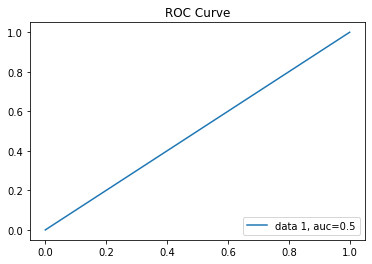

========== PRECISION-RECALL CURVE ==========


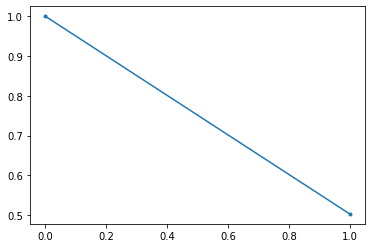

In [35]:
LogisticRegressionMLE(X_train, X_test, y_train, y_test)